<a href="https://colab.research.google.com/github/guebin/DL2024/blob/main/posts/07wk-1-2.ipynb"><img src="https://colab.research.google.com/assets/colab-badge.svg" style="text-align: left"></a>

# 1. 강의영상 

{{<video https://youtu.be/playlist?list=PLQqh36zP38-wCMWh9t92iWHuMtzrdA3Gv&si=F85VH6sGFIIEmmL_ >}}

# 2. Imports

In [1]:
import torch 
import torchvision
import fastai.vision.all
import matplotlib.pyplot as plt
import requests

# 3. XAI란?

<https://brunch.co.kr/@hvnpoet/140>

# 4. CAM의 구현을 위한 예비학습 (Class Activation Map)

## A. DLS : data loaders

In [2]:
path = fastai.data.external.untar_data(fastai.data.external.URLs.PETS)

라벨링이 대문자로 되어 있으면 고양이, 소문자로 되어 있으면 강아지

jpg 가 아닌 제대로되지 않은 mat 타입이 몇개 있다. 이를 jpg 타입만 추려서 사용하고 싶다.

In [3]:
# fastai.data.transforms.get_image_files() 에 이미지파일의 path 를 입력해서 fnames 이라 하자
fnames = fastai.data.transforms.get_image_files(path/'images')

In [4]:
def label_func(fname):
    if fname[0].isupper():
        return 'cat'
    else:
        return 'dog'

dls 방법1

In [5]:
dls = fastai.vision.data.ImageDataLoaders.from_name_func(
    path=path/'images',
    fnames = fnames,
    label_func = label_func,
    item_tfms = fastai.vision.augment.Resize(512),
    bs = 32
)

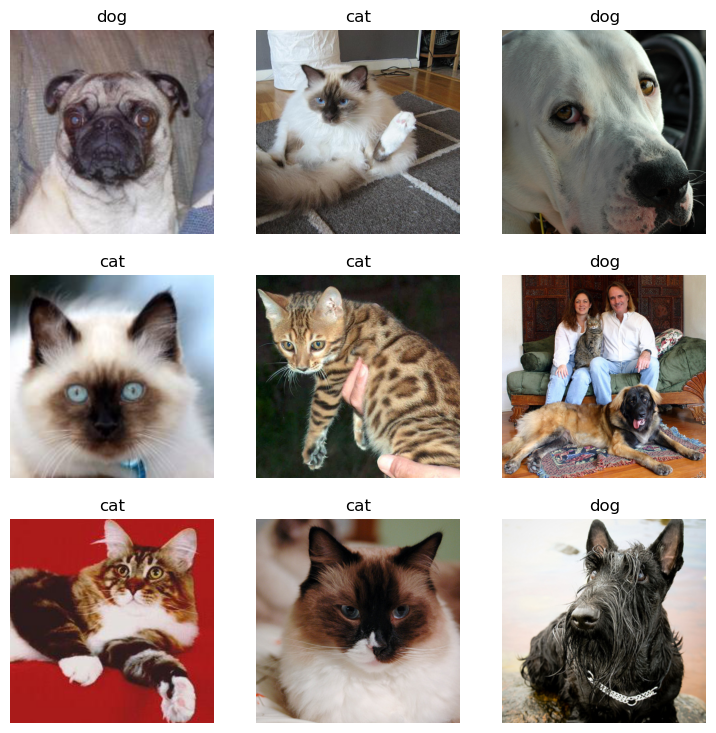

In [6]:
dls.show_batch()

## B. 이미지 자료 불러오기

`-` 원래 우리가 아는 방법: path를 의미하는 string $\to$ torch.tensor 

type: <class 'torch.Tensor'>
shape: torch.Size([3, 333, 500])
dtype: torch.uint8


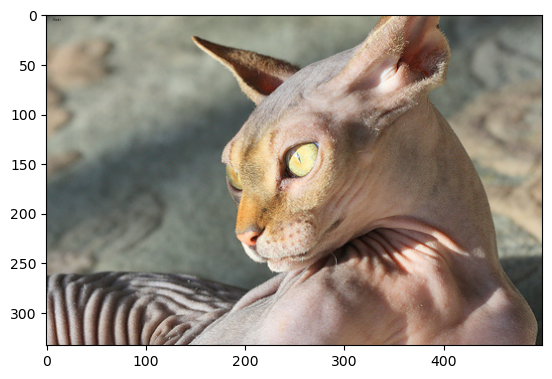

In [7]:
# x = torchvision.io.read_image('/home/myuser/.fastai/data/oxford-iiit-pet/images/Sphynx_14.jpg')
x = torchvision.io.read_image(path/'images/Sphynx_14.jpg')
print(f"type: {type(x)}")
print(f"shape: {x.shape}")
print(f"dtype: {x.dtype}")
plt.imshow(torch.einsum('ijk->jki',x))

## C. 이미지 자료 시각화 

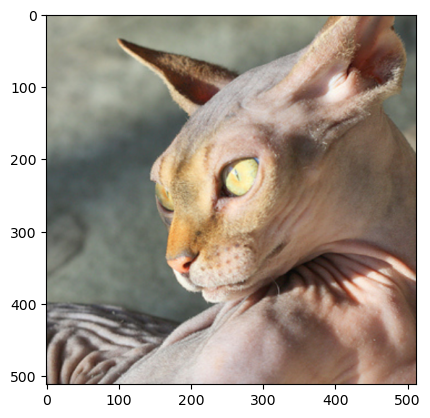

In [8]:
x_pil = fastai.vision.core.PILImage.create(path/'images/Sphynx_14.jpg')
x = next(iter(dls.test_dl([x_pil])))[0] # lrnr를 학습이후에는 여기에 저장되는 x값이 조금 달라지게됨, # obserbation 차원이 없음
x_dec = dls.decode([x])                 # obserbation 차원이 존재
plt.imshow(torch.einsum('ocij -> ijc', x_dec))

## D. AP layer 

In [9]:
# ap = torch.nn.AdaptiveAvgPool2d(output_size=1)
# ap

In [10]:
mp = torch.nn.AdaptiveMaxPool2d(output_size=1)

In [11]:
X = torch.arange(1*3*4*4).reshape(1,3,4,4)*1.0 
X

tensor([[[[ 0.,  1.,  2.,  3.],
          [ 4.,  5.,  6.,  7.],
          [ 8.,  9., 10., 11.],
          [12., 13., 14., 15.]],

         [[16., 17., 18., 19.],
          [20., 21., 22., 23.],
          [24., 25., 26., 27.],
          [28., 29., 30., 31.]],

         [[32., 33., 34., 35.],
          [36., 37., 38., 39.],
          [40., 41., 42., 43.],
          [44., 45., 46., 47.]]]])

In [12]:
# ap(X) # 채널별로 평균을 구해줌. 

In [13]:
mp(X)

tensor([[[[15.]],

         [[31.]],

         [[47.]]]])

In [14]:
flatten = torch.nn.Flatten()
# l = torch.nn.Linear(3,1,bias=False)

$$\underset{(n,3,4,4)}{\boldsymbol X} \overset{ap}{\to} \underset{(n,3,1,1)}{{\boldsymbol \sharp}}\overset{flatten}{\to} \underset{(n,3)}{{\boldsymbol \sharp}}\overset{linear}{\to} \underset{(n,1)}{\hat{\boldsymbol y}} = [[17.3],...]$$

$$\underset{(n,3,4,4)}{\boldsymbol X} \overset{linear}{\to} \underset{(n,1,4,4)}{{\boldsymbol \sharp}}\overset{ap}{\to} \underset{(n,1,1,1)}{{\boldsymbol \sharp}}\overset{flatten}{\to} \underset{(n,1)}{\hat{\boldsymbol y}} = [[17.3],...]$$

In [15]:
# 손실함수를 정의하지 않더라도, vision 의 경우는 알아서 cross entropy로 지정해준다. 생략가능! 
# optimizer, lr ,metric또한 생략 가능
lrnr = fastai.vision.learner.vision_learner(
    dls = dls,
    arch = fastai.vision.models.resnet34, 
    metrics = [fastai.metrics.accuracy]
)    

In [16]:
net1 = lrnr.model[0] # 2d-part : 학습에 핵심적인 요소
net2 = lrnr.model[1] # 1d-part : 정리하는 요소, 이 부분만 fine_tune으로 바꿔서, net1은 유지한채로 net2 wetight만 재학습한다는 의미

In [17]:
net1

Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Con

In [18]:
net2 # (8): in_features=512, out_features=2, ap->flatten->linear 구조

Sequential(
  (0): AdaptiveConcatPool2d(
    (ap): AdaptiveAvgPool2d(output_size=1)
    (mp): AdaptiveMaxPool2d(output_size=1)
  )
  (1): fastai.layers.Flatten(full=False)
  (2): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (3): Dropout(p=0.25, inplace=False)
  (4): Linear(in_features=1024, out_features=512, bias=False)
  (5): ReLU(inplace=True)
  (6): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (7): Dropout(p=0.5, inplace=False)
  (8): Linear(in_features=512, out_features=2, bias=False)
)

In [19]:
# net2 는 ap->flatten->linear 구조를 갖고 있다. 나는 조금 이따가 XAI를 위해 linear -> ap ->flatten 구조로 바꿀것이다.
net2[0] # ap
net2[1] # flatten
net2[8] # linear

Linear(in_features=512, out_features=2, bias=False)

In [20]:
# 하나의 배치를 테스트용으로 임시로 가져옴
_X, _y = dls.one_batch() 
_X.shape,_y.shape   # batch size : 32

(torch.Size([32, 3, 512, 512]), torch.Size([32]))

In [21]:
net1(_X.to("cpu")).shape    # ocij

torch.Size([32, 512, 16, 16])

In [22]:
net2[0](net1(_X.to("cpu"))).shape   #   ap

torch.Size([32, 1024, 1, 1])

In [23]:
net2[1](net2[0](net1(_X.to("cpu")))).shape   #   ap -> flatten

torch.Size([32, 1024])

In [24]:
net2(net1(_X.to("cpu"))).shape              # #   ap -> flatten -> linear

torch.Size([32, 2])

In [25]:
_X.device

device(type='cuda', index=0)

In [26]:
net1.to("cuda:0")
net2.to("cuda:0")
print(f"입력이미지:\t\t {_X.shape}")
print(f"net1통과직후:\t\t {net1(_X).shape}")
print(f"net2의AP까지통과직후:\t {net2[0](net1(_X)).shape}")
print(f"net2의Flatten까지통과직후:\t {net2[1](net2[0](net1(_X))).shape}")
print(f"net2끝까지통과:\t\t {net2(net1(_X)).shape}")
net1.to("cpu")
net2.to("cpu")

입력이미지:		 torch.Size([32, 3, 512, 512])
net1통과직후:		 torch.Size([32, 512, 16, 16])
net2의AP까지통과직후:	 torch.Size([32, 1024, 1, 1])
net2의Flatten까지통과직후:	 torch.Size([32, 1024])
net2끝까지통과:		 torch.Size([32, 2])


Sequential(
  (0): AdaptiveConcatPool2d(
    (ap): AdaptiveAvgPool2d(output_size=1)
    (mp): AdaptiveMaxPool2d(output_size=1)
  )
  (1): fastai.layers.Flatten(full=False)
  (2): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (3): Dropout(p=0.25, inplace=False)
  (4): Linear(in_features=1024, out_features=512, bias=False)
  (5): ReLU(inplace=True)
  (6): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (7): Dropout(p=0.5, inplace=False)
  (8): Linear(in_features=512, out_features=2, bias=False)
)

`-` net2를 아래와 같이 수정하자. (왜??)  4/6강 15분경
- 기존 
    - Sequential(
        (0): AdaptiveConcatPool2d(   
            (ap): AdaptiveAvgPool2d(output_size=1)   
            (mp): AdaptiveMaxPool2d(output_size=1)   
        )   
        (1): fastai.layers.Flatten(full=False)   
        (2): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)   
        (3): Dropout(p=0.25, inplace=False)   
        (4): Linear(in_features=1024, out_features=512, bias=False)   
        (5): ReLU(inplace=True)   
        (6): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)  
        (7): Dropout(p=0.5, inplace=False)  
        (8): Linear(in_features=512, out_features=2, bias=False)  
        )   
- 변경안 : ap -> flatten -> linear 으로 일단 단순화. 
    - XAI로 하기위해 조금 이따 linear -> ap -> flatten 으로 다시 한 번 바꿀예정

ap 가 아닌 mp로도 할 수 있다.

In [27]:
# mp -> flatten -> linear
net2 = torch.nn.Sequential(
    torch.nn.AdaptiveMaxPool2d(output_size=1), # [n, 512, 16, 16] --> [n, 512, 1, 1]
    torch.nn.Flatten(), # [n, 512, 1, 1] -->  [n, 512]
    torch.nn.Linear(512,2,bias=False) # [n,512] --> [n,2] 
)

In [28]:
net2[2] , _X.device

(Linear(in_features=512, out_features=2, bias=False),
 device(type='cuda', index=0))

In [29]:
net1.to("cuda:0")
net2.to("cuda:0")
(net1(_X)).shape , net2[0]((net1(_X))).shape  ,net2[1](net2[0]((net1(_X)))).shape ,net2[1](net2[0]((net1(_X)))).shape

# print(f"입력이미지:\t\t {_X.shape}")
# print(f"변경된 net1통과직후:\t\t {net1(_X).shape}")
# print(f"변경된 net2[0]의 mp 통과 직후:\t {net2[0]((net1(_X))).shape}")
# print(f"변경된 net2[1]의 Flatten 통과 직후:\t {net2[1](net2[0]((net1(_X)))).shape}")
# print(f"변경된 net2[2]의 linear 변환 통과:\t\t {net2(net1(_X)).shape}")
# net1.to("cpu")
# net2.to("cpu")

net1.to("cpu")
net2.to("cpu")

Sequential(
  (0): AdaptiveMaxPool2d(output_size=1)
  (1): Flatten(start_dim=1, end_dim=-1)
  (2): Linear(in_features=512, out_features=2, bias=False)
)

In [30]:
net = torch.nn.Sequential(
    net1, # 원래 resnet34에 있던거..
    net2 # 내가 (CAM을 위해서) 마음대로 바꾼것.. 
)
net.to("cuda:0")

Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

In [31]:
lrnr2 = fastai.learner.Learner(
    dls = dls, 
    model = net,
    metrics = [fastai.metrics.accuracy] 
)    

In [32]:
lrnr.loss_func, lrnr2.loss_func # loss_fn 은 따로 정의안했는데 알아서 잘 들어가 있음

(FlattenedLoss of CrossEntropyLoss(), FlattenedLoss of CrossEntropyLoss())

In [33]:
lrnr2.fine_tune(1) # net2를 내마음대로 수정했고, 그것에 대한 패널티로 accuracy가 안좋아짐! 그렇지만 그런대로 쓸만함. 

epoch,train_loss,valid_loss,accuracy,time
0,0.126334,0.024363,0.991881,00:36


epoch,train_loss,valid_loss,accuracy,time
0,0.030474,0.007901,0.996617,00:36


## C. 3단계-- 수정된 net2에서 Linear와 AP의 순서를 바꿈 
`-` 기존 : ap -> flatten -> linear
- Sequential(   
  (0): AdaptiveConcatPool2d(   
    (ap): AdaptiveAvgPool2d(output_size=1)   
    (mp): AdaptiveMaxPool2d(output_size=1)   
  )   
  (1): fastai.layers.Flatten(full=False)   
  (2): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)   
  (3): Dropout(p=0.25, inplace=False)   
  (4): Linear(in_features=1024, out_features=512, bias=False)  
  (5): ReLU(inplace=True)  
  (6): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)  
  (7): Dropout(p=0.5, inplace=False)  
  (8): Linear(in_features=512, out_features=2, bias=False)  
  )  

`-` 1개의 observation을 고정

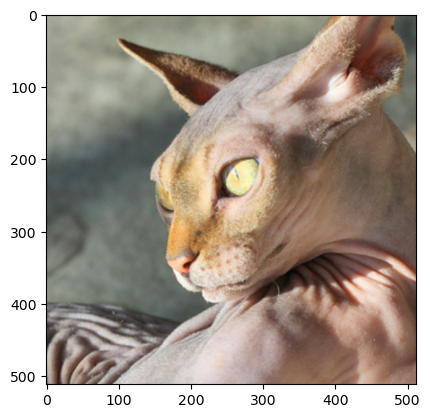

In [34]:
x_pil = fastai.vision.core.PILImage.create(path/'images/Sphynx_14.jpg')
x = next(iter(dls.test_dl([x_pil])))[0] # x는 네트워크 입력에 사용하고
x_dec = dls.decode([x])[0]              # x_dec는 plt.imshow로 보기위해 사용하자.
plt.imshow(torch.einsum('ocij -> ijc', x_dec))

net2 와 lrnr2.model[-1] 는 주소가 같다. 동일 객체라는 의미

In [35]:
id(net2) == id(lrnr2.model[-1])

True

In [36]:
id(net1) == id(lrnr2.model[0])

True

In [37]:
lrnr2.model[-1] # net2 는 mp , Flatten , Linear 순서로 됨

Sequential(
  (0): AdaptiveMaxPool2d(output_size=1)
  (1): Flatten(start_dim=1, end_dim=-1)
  (2): Linear(in_features=512, out_features=2, bias=False)
)

In [38]:
lrnr2.model[-1][0], lrnr2.model[-1][1], lrnr2.model[-1][2]

(AdaptiveMaxPool2d(output_size=1),
 Flatten(start_dim=1, end_dim=-1),
 Linear(in_features=512, out_features=2, bias=False))

In [39]:
(lrnr2.model[-1][2]).weight.data.shape

torch.Size([2, 512])

In [40]:
# 계산방식1: 원래계산방식 : mp -> fc -> linear
mp = lrnr2.model[-1][0]
fl = lrnr2.model[-1][1]
l = lrnr2.model[-1][2]
print(f"{x.shape} -- x")
# step 1 : net1의 conv 를 통해 feature 추출
print(f"{net1(x).shape} -- net1(x)")
# step 2 : 추출된 feature 를 AdaptiveAvgPool2d 함 기본 3x512x512 사이즈의 이미지가 1x1 의 float타입의 수 한개로 압축됨. 
print(f"{mp(net1(x)).shape} -- mp(net1(x))")
# step 3 : fully connected layer
print(f"{fl(mp(net1(x))).shape} -- flatten(mp(net1(x)))")
# step 4 : 다시 선형결합. 출력결과는 softmax의 input으로 들어간다.
print(f"{l(fl(mp(net1(x)))).shape} -- l(flatten(mp(net1(x))))")
# l(fl(mp(net1(x))))
print(f"l(fl(mp(net1(x)))) : {l(fl(mp(net1(x)))).data}")
print(f"고양이일 가능성 : {l(fl(mp(net1(x))))[0][0].data}")
print(f"강아지일 가능성 : {l(fl(mp(net1(x))))[0][1].data}")

torch.Size([1, 3, 512, 512]) -- x
torch.Size([1, 512, 16, 16]) -- net1(x)
torch.Size([1, 512, 1, 1]) -- mp(net1(x))
torch.Size([1, 512]) -- flatten(mp(net1(x)))
torch.Size([1, 2]) -- l(flatten(mp(net1(x))))
l(fl(mp(net1(x)))) : TensorImage([[ 7.3534, -7.0585]], device='cuda:0')
고양이일 가능성 : TensorImage(7.3534, device='cuda:0')
강아지일 가능성 : TensorImage(-7.0585, device='cuda:0')


torch.Size([1, 16, 16])


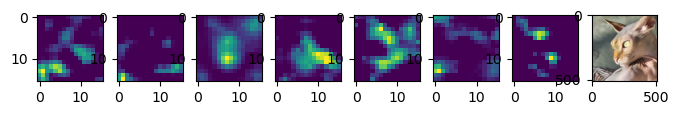

In [41]:
# net1의 출력
print((net1(x))[:,0,:,:].shape)
(net1(x))[:,0,:,:].data.to("cpu")

fig,ax = plt.subplots(1,8,figsize=(8,4))

# 이러한 16x16 feature에 대한 채널이 512개가 있다는 말.. 이건 인간에게 직관적이지 않다.
ax[0].imshow(torch.einsum('oij->ij',(net1(x))[:,0,:,:].data.to("cpu")))
ax[1].imshow(torch.einsum('oij->ij',(net1(x))[:,1,:,:].data.to("cpu")))
ax[2].imshow(torch.einsum('oij->ij',(net1(x))[:,2,:,:].data.to("cpu")))
ax[3].imshow(torch.einsum('oij->ij',(net1(x))[:,3,:,:].data.to("cpu")))
ax[4].imshow(torch.einsum('oij->ij',(net1(x))[:,4,:,:].data.to("cpu")))
ax[5].imshow(torch.einsum('oij->ij',(net1(x))[:,5,:,:].data.to("cpu")))
ax[6].imshow(torch.einsum('oij->ij',(net1(x))[:,6,:,:].data.to("cpu")))

ax[7].imshow(torch.einsum('ocij -> ijc', x_dec),cmap='magma')


In [42]:
print(f"x 가 net1과 mp를 통과한 값 {mp(net1(x))[0,0]} -- mp(net1(x))")

x 가 net1과 mp를 통과한 값 TensorImage([[5.6273]], device='cuda:0', grad_fn=<AliasBackward0>) -- mp(net1(x))


기존의 AP , Flatten , Linear 순서로 된 net2 를 **linear, Ap, Flatten 순서**로 바꿔보고싶다. 
- AP , Flatten , Linear 순서로 하나, linear, Ap, Flatten 순서로 하나 결과값은 똑같다. 그러니 순서는 바꿔도 결과에 아무 영향이 없으므로 바꿔도 된다.
- 그럼 왜 순서를 바꾸느냐? Linear 를 먼저했을때, 그떄의 이미지를 plt로 보면 인간이 직관적으로 이해할 수 있어서

**net2의 순서 바꾸기 전 전체 네트워크**
$$\underset{(1,3,512,512)}{\boldsymbol x} \overset{net_1}{\to} \left( \underset{(1,512,16,16)}{\tilde{\boldsymbol x}} \overset{ap}{\to} \underset{(1,512,1,1)}{{\boldsymbol \sharp}}\overset{flatten}{\to} \underset{(1,512)}{{\boldsymbol \sharp}}\overset{linear}{\to} \underset{(1,2)}{\hat{\boldsymbol y}}\right) = [[2.7846, -2.7945]]$$

In [43]:
net1(x).shape

torch.Size([1, 512, 16, 16])

In [44]:
# l = lrnr2.model[-1][2]
l.weight.data , l.weight.data.shape # input 512, output 2

(tensor([[ 0.0023, -0.0280,  0.0228,  ...,  0.0200, -0.0114,  0.0032],
         [-0.0327, -0.0075, -0.0086,  ...,  0.0121, -0.0168, -0.0202]],
        device='cuda:0'),
 torch.Size([2, 512]))

In [45]:
# 기존의 mp , Flatten , Linear 순서로 된 net2 를 linear, mp, Flatten 순서로 바꿔보고싶다. 
# 이미 fine_tune을 통해 net1에 대한 학습을 끝내서, 개와 고양이에 대한 feature는 기가막히게 잘 따는 상황

# 계산방식2: net2의 순서를 바꾼 계산 (mp,flatten,linear 에서 linear,flatten,ap로 바꿈) 어차피 결과는 똑같을거고, 기존 classification 성능에 악영향을 끼치지 않을거라는 판단. 결과는 같다.
# 그래도 결과는 똑같겠죠.
mp = lrnr2.model[-1][0]
fl = lrnr2.model[-1][1]
l = lrnr2.model[-1][2]
WHY = torch.einsum('ocij,kc -> okij', net1(x), l.weight.data)   # linear
print(f"{x.shape} -- x")
print(f"{net1(x).shape} -- net1(x)")
print("=======================================")
print(f"{WHY.shape} -- l(net1(x)):=WHY")                        # linear
print(f"{mp(WHY).shape} -- mp(l(net1(x)))=mp(WHY)")             # linear mp
print(f"{fl(mp(WHY)).shape} -- flatten(mp(l(net1(x)))))=flatten(mp(WHY))")  # linear mp flatten
fl(mp(torch.einsum('ocij,kc -> okij', net1(x), l.weight.data))).detach() # linear mp flatten 결과값

torch.Size([1, 3, 512, 512]) -- x
torch.Size([1, 512, 16, 16]) -- net1(x)
torch.Size([1, 2, 16, 16]) -- l(net1(x)):=WHY
torch.Size([1, 2, 1, 1]) -- mp(l(net1(x)))=mp(WHY)
torch.Size([1, 2]) -- flatten(mp(l(net1(x)))))=flatten(mp(WHY))


TensorImage([[9.4148, 0.9402]], device='cuda:0')

In [46]:
WHY.device

device(type='cuda', index=0)

In [47]:
WHY.shape

torch.Size([1, 2, 16, 16])

In [48]:
WHY[0,0].shape , WHY[0,1].shape # WHY는 len이 2이며, 각 len는 이미지 분류 클래스에 대한 feature 정보를 갖고있다.

(torch.Size([16, 16]), torch.Size([16, 16]))

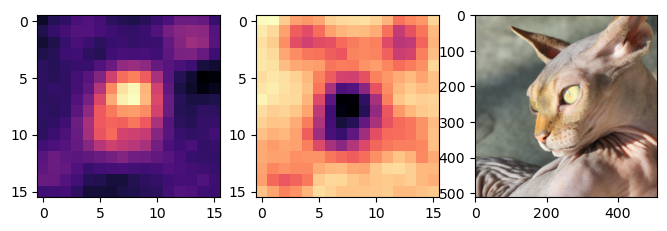

In [49]:
WHY = torch.einsum('ocij,kc -> okij', net1(x), l.weight.data)   # linear
fig,ax = plt.subplots(1,3,figsize=(8,4))
ax[0].imshow(WHY.to("cpu")[0,0].data,cmap='magma')  # 노랗게 물들인 부분(확신하는 부분)의 수치가 컸고, 이 값이 컸기때문에 최종 ap 와 fl에도 영향을 끼쳤음.
ax[1].imshow(WHY.to("cpu")[0,1].data,cmap='magma')
ax[2].imshow(torch.einsum('ocij -> ijc', x_dec),cmap='magma')


In [50]:
l.weight.data

tensor([[ 0.0023, -0.0280,  0.0228,  ...,  0.0200, -0.0114,  0.0032],
        [-0.0327, -0.0075, -0.0086,  ...,  0.0121, -0.0168, -0.0202]],
       device='cuda:0')

AP , Flatten , Linear 순서로 된 net2 를 linear, Ap, Flatten 순서로 바꿔보고싶다. 
- AP , Flatten , Linear 순서로 하나, linear, Ap, Flatten 순서로 하나 결과값은 똑같다.

**net2의 순서를 바꾼후 전체 네트워크**
$$\underset{(1,3,224,224)}{\boldsymbol x} \overset{net_1}{\to} \left( \underset{(1,512,16,16)}{\tilde{\boldsymbol x}} \overset{linear}{\to} \underset{(1,2,16,16)}{{\bf WHY}}\overset{ap}{\to} \underset{(1,2,1,1)}{{\boldsymbol \sharp}}\overset{flatten}{\to} \underset{(1,2)}{\hat{\boldsymbol y}}\right) = [[2.7846,-2.7945]]$$

- 참고: 여기에서 linear는 (1,512,16,16)의 each pixel에 `torch.nn.Linear(512,2)`를 수행함.

### $\star$ 잠깐 멈추고 생각 좀 해보자..
- net2의 순서를 바꿔도 똑같은건 알겠다.. 근데 왜 이 작업을 했느냐..?

`-` 입력이미지 

In [51]:
x.shape

torch.Size([1, 3, 512, 512])

In [52]:
x_pil, x

(PILImage mode=RGB size=500x333,
 TensorImage([[[[ 0.8104,  0.7933,  0.7762,  ..., -0.6794, -0.6794, -0.6794],
                [ 0.8104,  0.7933,  0.7762,  ..., -0.6965, -0.6965, -0.6965],
                [ 0.8104,  0.7933,  0.7762,  ..., -0.7137, -0.7137, -0.7137],
                ...,
                [-0.6623, -0.2171,  0.3138,  ...,  0.5707,  0.5364,  0.5022],
                [-0.7650, -0.3541,  0.1597,  ...,  0.5707,  0.5193,  0.4851],
                [-0.8335, -0.4568,  0.0398,  ...,  0.5707,  0.5193,  0.4679]],
 
               [[ 0.9930,  0.9755,  0.9580,  ..., -0.5301, -0.5126, -0.4951],
                [ 0.9930,  0.9755,  0.9580,  ..., -0.5301, -0.5126, -0.4951],
                [ 1.0105,  0.9930,  0.9580,  ..., -0.5126, -0.4951, -0.4951],
                ...,
                [-1.0553, -0.5301,  0.1527,  ..., -0.0399,  0.0126,  0.0476],
                [-1.1604, -0.6527,  0.0301,  ...,  0.0301,  0.0651,  0.0651],
                [-1.2479, -0.7402, -0.0574,  ...,  0.0826,  0.08

`-` 원래 net2를 그대로 적용한 결과를 해석 

In [53]:
net2    # ap, flatten ,Linear

Sequential(
  (0): AdaptiveMaxPool2d(output_size=1)
  (1): Flatten(start_dim=1, end_dim=-1)
  (2): Linear(in_features=512, out_features=2, bias=False)
)

In [54]:
net2(net1(x))

TensorImage([[ 7.3534, -7.0585]], device='cuda:0', grad_fn=<AliasBackward0>)

- "2.7846 > -2.7945" 이므로, `ximg`는 높은 확률로 고양이라는 것을 의미함. 

AP , Flatten , Linear 순서로 된 net2 를 linear, Ap, Flatten 순서로 바꿔보고싶다. 
- AP , Flatten , Linear 순서로 하나, linear, Ap, Flatten 순서로 하나 결과값은 똑같다.   (AP는 항상 Flatten보다 앞서 계산되어야 한다.)

`-` 바뀐 net2를 적용해볼까? 

In [55]:
#WHY = torch.einsum('ocij,kc -> okij', net1(x), l.weight.data)   # linear 

print(f"{x.shape} -- x")
print(f"{net1(x).shape} -- net1(x)")
print("=======================================")
print(f"{WHY.shape} -- l(net1(x)):=WHY")                        # linear

WHY.shape # WHY 는 net1 의 출력에 linear 변환을 한 결과를 의미

torch.Size([1, 3, 512, 512]) -- x
torch.Size([1, 512, 16, 16]) -- net1(x)
torch.Size([1, 2, 16, 16]) -- l(net1(x)):=WHY


torch.Size([1, 2, 16, 16])

In [56]:
# 계산방법 2
flatten(mp(WHY))        # linear , ap , flatten

TensorImage([[9.4148, 0.9402]], device='cuda:0', grad_fn=<AliasBackward0>)

In [57]:
WHY[0,0,:,:].shape

torch.Size([16, 16])

In [58]:
mp(WHY) , mp(WHY).shape

(TensorImage([[[[9.4148]],
 
               [[0.9402]]]], device='cuda:0', grad_fn=<AliasBackward0>),
 torch.Size([1, 2, 1, 1]))

In [59]:
WHY[0,0,:,:].mean() # 이 값이 클수록 고양이

TensorImage(1.0770, device='cuda:0', grad_fn=<AliasBackward0>)

In [60]:
WHY[0,1,:,:].mean() # 이 값이 클수록 강아지 

TensorImage(-1.5990, device='cuda:0', grad_fn=<AliasBackward0>)

`-` 좀더 파고들어서 분석해보자. 

In [61]:
WHY[0,0,:,:].int() # 이 값들의 평균이 2.7846임. 그리고 이 평균값이 클수록 고양이

TensorImage([[-1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  1,  1,  0],
             [ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  2,  2,  2,  0],
             [-1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  2,  2,  2,  0],
             [ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  1,  1,  1,  0],
             [ 0,  0,  0,  0,  0,  0,  1,  2,  2,  2,  1,  0,  0,  0, -1, -1],
             [ 0,  0,  0,  0,  0,  2,  4,  5,  6,  5,  3,  0,  0, -1, -2, -2],
             [ 0,  0,  0,  0,  1,  3,  6,  8,  9,  7,  4,  1,  0, -1, -2, -1],
             [ 0,  0,  0,  0,  1,  4,  7,  9,  9,  7,  4,  1,  0,  0,  0,  0],
             [ 0,  0,  0,  0,  2,  5,  6,  6,  7,  6,  4,  1,  0,  0,  0,  0],
             [ 0,  0,  0,  1,  3,  5,  5,  5,  6,  5,  3,  0,  0,  0,  0,  0],
             [ 0,  0,  0,  1,  3,  5,  5,  4,  4,  3,  2,  0,  0,  0,  0,  0],
             [ 0,  0,  0,  1,  2,  3,  4,  3,  3,  3,  1,  0,  0,  0,  0,  0],
             [ 0,  1,  0,  0,  1,  1,  1,  2,  1,  1

- 이 값들의 평균은 2.7846임. 
- 이 값들이 클수록 이 그림은 고양이라는 의미임 = 이 값이 작을수록 이 그림은 고양이 그림이 아니라는 의미임. 
- 그런데 살펴보니 **대부분의 위치에서 0에 가까운 값**을 가지고, **특정 위치에서만 엄청 큰 값**이 있어서 2.7846이라는 값이 나온 것임. 
- 특정위치에 존재하는 엄청 큰 값들은, `x`가 고양이 이미지라고 판단하는 근거가 된다. 

In [62]:
WHY[0,1,:,:].int() # 이 값들의 평균이 -2.7945임. 그리고 이 평균값이 클수록 강아지.  WHY 행렬이 곧이어 ap로 들어가는데, WHY의 특정 부분에 큰 값이 있다면 당연히 ap의 평균치에도 영향을 끼치고, 이는 classification의 최종 확률을 평가하는데도 사용되어, AI의 판단근거를 제시해준다.

TensorImage([[ 0,  0,  0,  0, -1,  0,  0,  0,  0,  0,  0,  0, -1, -1, -1,  0],
             [ 0,  0, -1, -2, -2, -2, -1,  0,  0,  0,  0, -1, -3, -2, -1,  0],
             [ 0,  0, -1, -2, -3, -2, -2, -2, -1, -1, -1, -2, -3, -3, -2,  0],
             [ 0,  0,  0, -1, -1, -1, -2, -2, -1, -1, -1, -2, -3, -3, -1,  0],
             [ 0,  0,  0,  0,  0, -1, -1, -1, -1, -1, -1, -1, -2, -1, -1,  0],
             [ 0,  0,  0,  0,  0, -1, -2, -3, -3, -2, -1, -1,  0,  0,  0,  0],
             [ 0,  0,  0,  0,  0, -1, -4, -6, -6, -4, -2, -1,  0,  0,  0,  0],
             [ 0,  0,  0,  0,  0, -2, -6, -8, -8, -7, -4, -1,  0,  0,  0,  0],
             [ 0,  0,  0,  0,  0, -3, -6, -8, -8, -7, -4, -2, -1,  0,  0,  0],
             [ 0,  0,  0,  0, -1, -4, -6, -7, -7, -5, -4, -2, -2, -1, -1,  0],
             [ 0,  0,  0,  0, -2, -4, -6, -6, -6, -4, -2, -2, -2, -1, -1,  0],
             [ 0, -1,  0, -1, -1, -2, -4, -4, -4, -3, -2, -1, -1, -1, -1,  0],
             [ 0,  0,  0, -1, -1, -1, -1, -2, -2, -2

- 이 값들의 평균은 -2.7945임. 
- 이 값들이 클수록 이 그림은 강아지라는 의미임 = 이 값이 작을수록 이 그림은 강아지가 아니라는 의미임. 
- 그런데 살펴보니 **대부분의 위치에서 0에 가까운 값**을 가지고, **특정 위치에서만 엄청 큰 작은값**이 있어서 -2.7945라는 값이 나온 것임. 
- 특정위치에 존재하는 엄청 큰 작은값들은, `x`가 강아지 이미지가 아니라고 판단하는 근거가 된다. 

$$\underset{(1,2,16,16)}{{\bf WHY}}\overset{ap}{\to} \underset{(1,2,1,1)}{{\boldsymbol \sharp}}\overset{flatten}{\to} \underset{(1,2)}{\hat{\boldsymbol y}} = [[2.7846,-2.7945]]$$

`-` 시각화1 

In [63]:
WHYCAT = WHY[0,0,:,:].to("cpu").detach()
WHYDOG = WHY[0,1,:,:].to("cpu").detach()

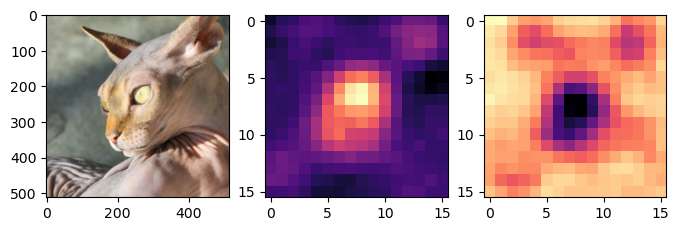

In [64]:
fig,ax = plt.subplots(1,3,figsize=(8,4))
ax[0].imshow(torch.einsum('ocij -> ijc',x_dec))
ax[1].imshow(WHYCAT,cmap='magma')
ax[2].imshow(WHYDOG,cmap='magma')

- magma: 검은색 < 보라색 < 빨간색 < 노란색 
- 가운데 그림의 노란부분은 고양이라는 증거, 오른쪽 그림의 검보라색 부분은 강아지가 아니라는 증거

`-` 시각화2

In [65]:
WHYCAT.shape

torch.Size([16, 16])

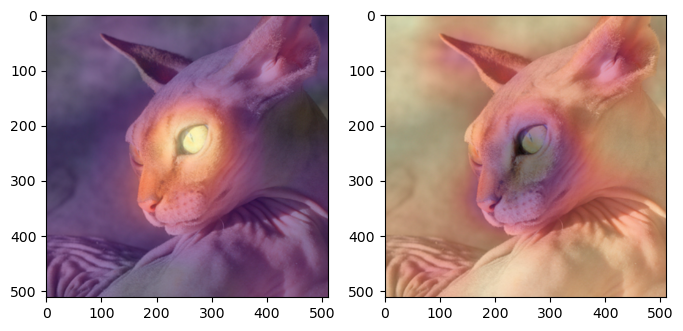

In [66]:
fig,ax = plt.subplots(1,2,figsize=(8,4))
ax[0].imshow(torch.einsum('ocij -> ijc',x_dec))
ax[0].imshow(WHYCAT,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
ax[1].imshow(torch.einsum('ocij -> ijc',x_dec))
ax[1].imshow(WHYDOG,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)

`-` 하니를 활용한 시각화 

In [68]:
x_pil = fastai.vision.core.PILImage.create(requests.get('https://github.com/guebin/DL2024/blob/main/imgs/01wk-hani1.jpeg?raw=true').content)
x = next(iter(dls.test_dl([x_pil])))[0] # lrnr를 학습이후에는 여기에 저장되는 x값이 조금 달라지게됨
x_dec = dls.decode([x])
WHY = torch.einsum('ocij,kc -> okij', net1(x), l.weight.data)
WHYCAT = WHY[0,0,:,:].to("cpu").detach()
WHYDOG = WHY[0,1,:,:].to("cpu").detach()
softmax = torch.nn.Softmax(dim=1)
cat_prob, dog_prob = softmax(flatten(mp(WHY))).to("cpu").detach().tolist()[0]

Text(0.5, 1.0, 'dog prob = 0.931717')

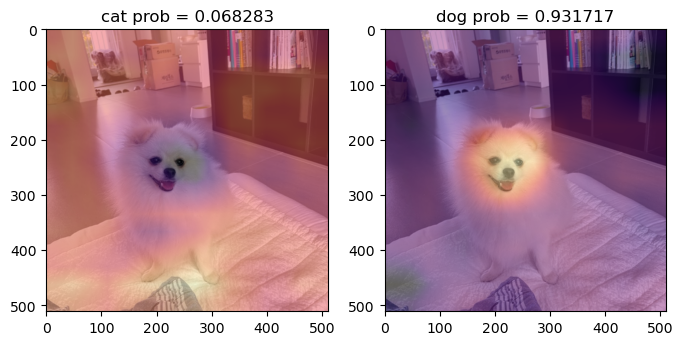

In [69]:
fig,ax = plt.subplots(1,2,figsize=(8,4))
ax[0].imshow(torch.einsum('ocij -> ijc',x_dec))
ax[0].imshow(WHYCAT,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
ax[0].set_title(f"cat prob = {cat_prob:.6f}")
ax[1].imshow(torch.einsum('ocij -> ijc',x_dec))
ax[1].imshow(WHYDOG,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
ax[1].set_title(f"dog prob = {dog_prob:.6f}")

In [70]:
x_pil = fastai.vision.core.PILImage.create(requests.get('https://image.kmib.co.kr/online_image/2020/1122/611718110015239102_4.jpg').content)
x = next(iter(dls.test_dl([x_pil])))[0] # lrnr를 학습이후에는 여기에 저장되는 x값이 조금 달라지게됨
x_dec = dls.decode([x])
WHY = torch.einsum('ocij,kc -> okij', net1(x), l.weight.data)
WHYCAT = WHY[0,0,:,:].to("cpu").detach()
WHYDOG = WHY[0,1,:,:].to("cpu").detach()
softmax = torch.nn.Softmax(dim=1)
cat_prob, dog_prob = softmax(flatten(mp(WHY))).to("cpu").detach().tolist()[0]

Text(0.5, 1.0, 'dog prob = 0.003346')

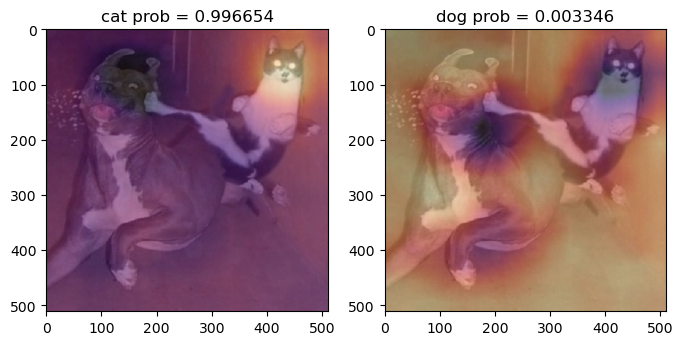

In [71]:
fig,ax = plt.subplots(1,2,figsize=(8,4))
ax[0].imshow(torch.einsum('ocij -> ijc',x_dec))
ax[0].imshow(WHYCAT,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
ax[0].set_title(f"cat prob = {cat_prob:.6f}")
ax[1].imshow(torch.einsum('ocij -> ijc',x_dec))
ax[1].imshow(WHYDOG,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
ax[1].set_title(f"dog prob = {dog_prob:.6f}")

Text(0.5, 1.0, 'dog prob = 0.153887')

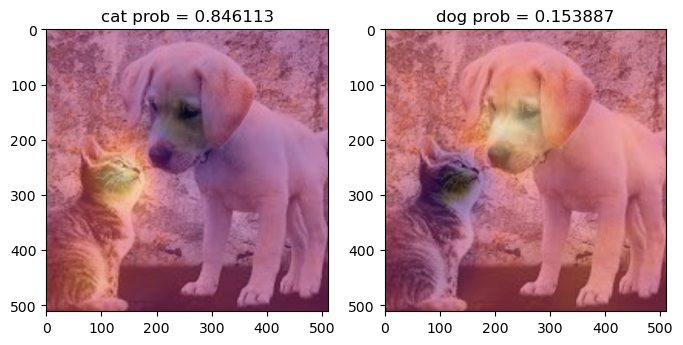

In [72]:
x_pil = fastai.vision.core.PILImage.create(requests.get('https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcT2whJUyCagyvwmQDT-hy-N_P9kuBIeZrwR8A&s').content)
x = next(iter(dls.test_dl([x_pil])))[0] # lrnr를 학습이후에는 여기에 저장되는 x값이 조금 달라지게됨
x_dec = dls.decode([x])
WHY = torch.einsum('ocij,kc -> okij', net1(x), l.weight.data)
WHYCAT = WHY[0,0,:,:].to("cpu").detach()
WHYDOG = WHY[0,1,:,:].to("cpu").detach()
softmax = torch.nn.Softmax(dim=1)
cat_prob, dog_prob = softmax(flatten(mp(WHY))).to("cpu").detach().tolist()[0]
fig,ax = plt.subplots(1,2,figsize=(8,4))
ax[0].imshow(torch.einsum('ocij -> ijc',x_dec))
ax[0].imshow(WHYCAT,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
ax[0].set_title(f"cat prob = {cat_prob:.6f}")
ax[1].imshow(torch.einsum('ocij -> ijc',x_dec))
ax[1].imshow(WHYDOG,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
ax[1].set_title(f"dog prob = {dog_prob:.6f}")

Text(0.5, 1.0, 'dog prob = 0.006082')

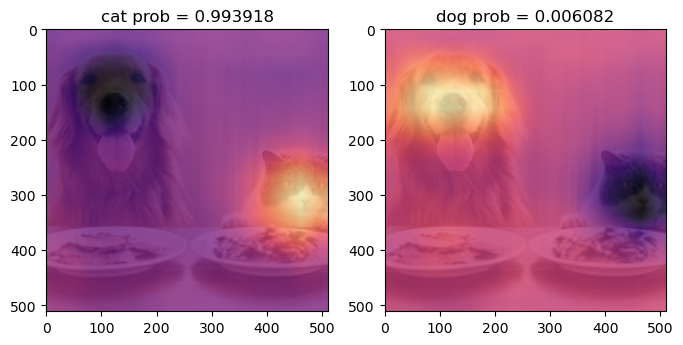

In [73]:
x_pil = fastai.vision.core.PILImage.create(requests.get('https://cdn.salgoonews.com/news/photo/202201/15410_38444_1522.jpg').content)
x = next(iter(dls.test_dl([x_pil])))[0] # lrnr를 학습이후에는 여기에 저장되는 x값이 조금 달라지게됨
x_dec = dls.decode([x])
WHY = torch.einsum('ocij,kc -> okij', net1(x), l.weight.data)
WHYCAT = WHY[0,0,:,:].to("cpu").detach()
WHYDOG = WHY[0,1,:,:].to("cpu").detach()
softmax = torch.nn.Softmax(dim=1)
cat_prob, dog_prob = softmax(flatten(mp(WHY))).to("cpu").detach().tolist()[0]
fig,ax = plt.subplots(1,2,figsize=(8,4))
ax[0].imshow(torch.einsum('ocij -> ijc',x_dec))
ax[0].imshow(WHYCAT,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.8)
ax[0].set_title(f"cat prob = {cat_prob:.6f}")
ax[1].imshow(torch.einsum('ocij -> ijc',x_dec))
ax[1].imshow(WHYDOG,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.8)
ax[1].set_title(f"dog prob = {dog_prob:.6f}")

Text(0.5, 1.0, 'dog prob = 0.985282')

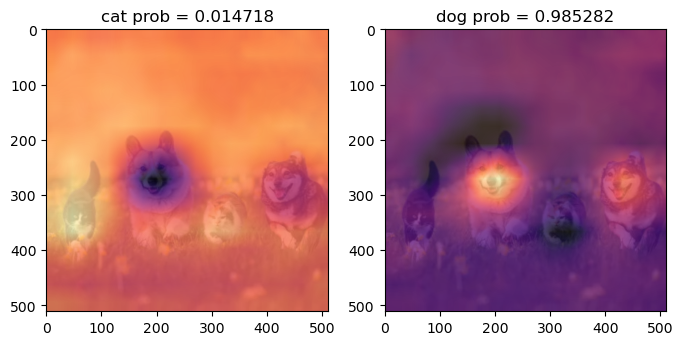

In [74]:
x_pil = fastai.vision.core.PILImage.create(requests.get('https://media.istockphoto.com/id/2128245344/ko/%EC%82%AC%EC%A7%84/%EA%B7%80%EC%97%AC%EC%9A%B4-%ED%84%B8%EB%B3%B5%EC%88%AD%EC%9D%B4-%EC%B9%9C%EA%B5%AC%EB%93%A4-%EB%91%90-%EB%A7%88%EB%A6%AC%EC%9D%98-%EA%B3%A0%EC%96%91%EC%9D%B4%EC%99%80-%EB%91%90-%EB%A7%88%EB%A6%AC%EC%9D%98-%EC%BE%8C%ED%99%9C%ED%95%9C-%EA%B0%9C%EA%B0%80-%ED%99%94%EC%B0%BD%ED%95%9C-%EB%B4%84%EB%82%A0-%ED%91%B8%EB%A5%B8-%EC%B4%88%EC%9B%90%EC%9D%84-%ED%95%A8%EA%BB%98-%EB%8B%AC%EB%A6%BD%EB%8B%88%EB%8B%A4.webp?b=1&s=612x612&w=0&k=20&c=M_myuRE0BJic4Mh3zy7_NqYe_pq-rBkFYAf7KbW222U=').content)
x = next(iter(dls.test_dl([x_pil])))[0] # lrnr를 학습이후에는 여기에 저장되는 x값이 조금 달라지게됨
x_dec = dls.decode([x])
WHY = torch.einsum('ocij,kc -> okij', net1(x), l.weight.data)
WHYCAT = WHY[0,0,:,:].to("cpu").detach()
WHYDOG = WHY[0,1,:,:].to("cpu").detach()
softmax = torch.nn.Softmax(dim=1)
cat_prob, dog_prob = softmax(flatten(mp(WHY))).to("cpu").detach().tolist()[0]
fig,ax = plt.subplots(1,2,figsize=(8,4))
ax[0].imshow(torch.einsum('ocij -> ijc',x_dec))
ax[0].imshow(WHYCAT,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.8)
ax[0].set_title(f"cat prob = {cat_prob:.6f}")
ax[1].imshow(torch.einsum('ocij -> ijc',x_dec))
ax[1].imshow(WHYDOG,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.8)
ax[1].set_title(f"dog prob = {dog_prob:.6f}")

## D. 4단계 -- CAM 시각화 

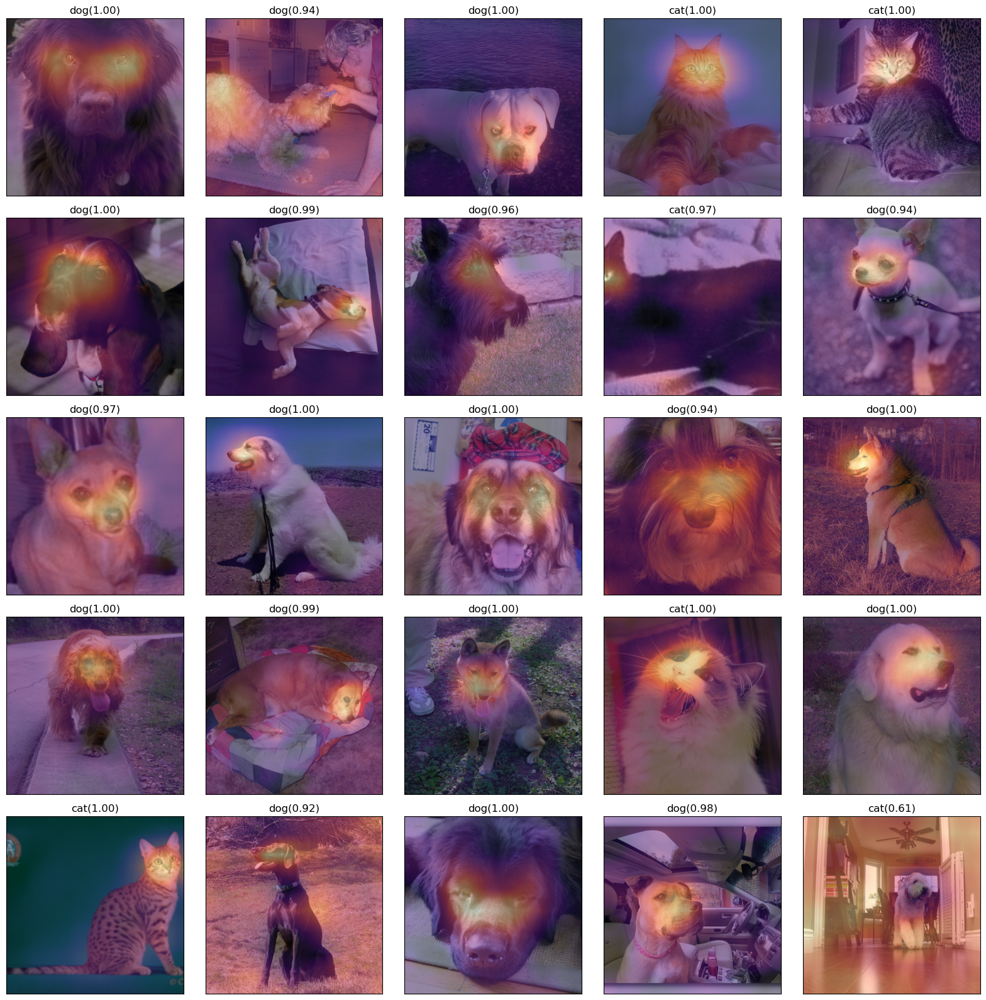

In [75]:
fig,ax = plt.subplots(5,5)
#---#
k=0
for i in range(5):
    for j in range(5):
        x_pil = fastai.vision.core.PILImage.create(fastai.data.transforms.get_image_files(path/'images')[k])
        x = next(iter(dls.test_dl([x_pil])))[0] # 이걸로 WHY를 만들어보자. 
        x_dec = dls.decode([x])[0] # 이걸로 시각화 
        WHY = torch.einsum('ocij,kc -> okij',net1(x),l.weight.data)
        WHYCAT = WHY[0,0,:,:].to("cpu").detach()
        WHYDOG = WHY[0,1,:,:].to("cpu").detach()
        cat_prob, dog_prob = softmax(flatten(mp(WHY))).to("cpu").detach().tolist()[0]
        if cat_prob > dog_prob: 
            ax[i][j].imshow(torch.einsum('ocij -> ijc',x_dec))
            ax[i][j].imshow(WHYCAT,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
            ax[i][j].set_title(f"cat({cat_prob:.2f})")
            ax[i][j].set_xticks([])
            ax[i][j].set_yticks([])            
        else: 
            ax[i][j].imshow(torch.einsum('ocij -> ijc',x_dec))
            ax[i][j].imshow(WHYDOG,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
            ax[i][j].set_title(f"dog({dog_prob:.2f})")
            ax[i][j].set_xticks([])
            ax[i][j].set_yticks([])            
        k=k+1
fig.set_figheight(16)
fig.set_figwidth(16)
fig.tight_layout()

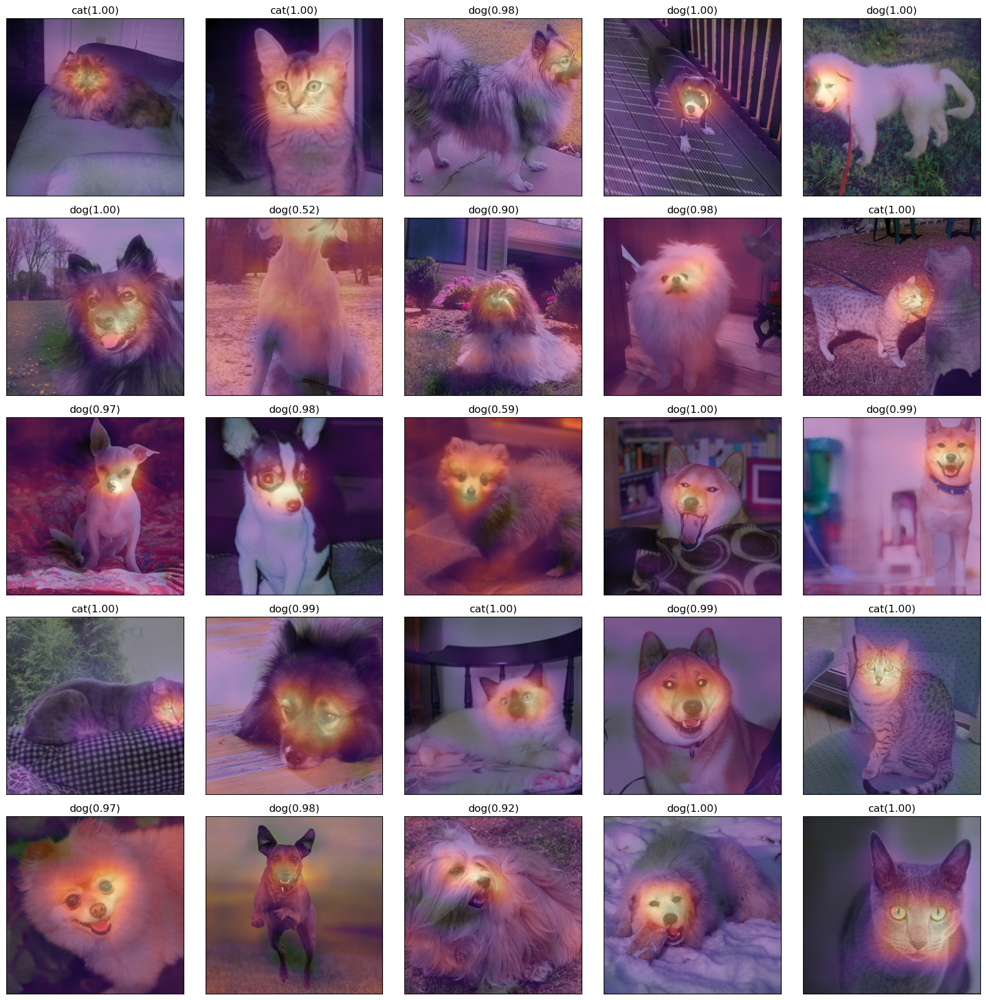

In [76]:
fig,ax = plt.subplots(5,5)
#---#
k=25
for i in range(5):
    for j in range(5):
        x_pil = fastai.vision.core.PILImage.create(fastai.data.transforms.get_image_files(path/'images')[k])
        x = next(iter(dls.test_dl([x_pil])))[0] # 이걸로 WHY를 만들어보자. 
        x_dec = dls.decode([x])[0] # 이걸로 시각화 
        WHY = torch.einsum('ocij,kc -> okij',net1(x),l.weight.data)
        WHYCAT = WHY[0,0,:,:].to("cpu").detach()
        WHYDOG = WHY[0,1,:,:].to("cpu").detach()
        cat_prob, dog_prob = softmax(flatten(mp(WHY))).to("cpu").detach().tolist()[0]
        if cat_prob > dog_prob: 
            ax[i][j].imshow(torch.einsum('ocij -> ijc',x_dec))
            ax[i][j].imshow(WHYCAT,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
            ax[i][j].set_title(f"cat({cat_prob:.2f})")
            ax[i][j].set_xticks([])
            ax[i][j].set_yticks([])
        else: 
            ax[i][j].imshow(torch.einsum('ocij -> ijc',x_dec))
            ax[i][j].imshow(WHYDOG,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
            ax[i][j].set_title(f"dog({dog_prob:.2f})")
            ax[i][j].set_xticks([])
            ax[i][j].set_yticks([])            
        k=k+1
fig.set_figheight(16)
fig.set_figwidth(16)
fig.tight_layout() 

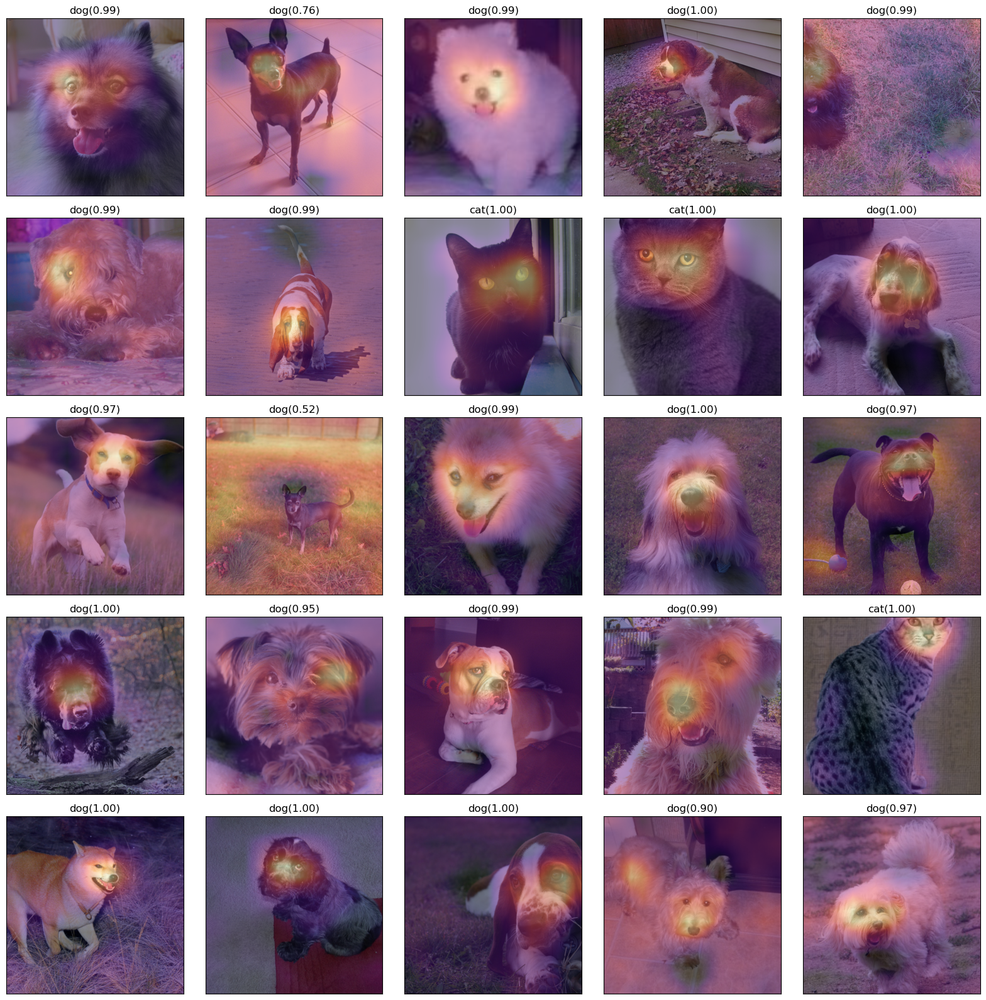

In [78]:
fig,ax = plt.subplots(5,5)
#---#
k=50
for i in range(5):
    for j in range(5):
        x_pil = fastai.vision.core.PILImage.create(fastai.data.transforms.get_image_files(path/'images')[k])
        x = next(iter(dls.test_dl([x_pil])))[0] # 이걸로 WHY를 만들어보자. 
        x_dec = dls.decode([x])[0] # 이걸로 시각화 
        WHY = torch.einsum('ocij,kc -> okij',net1(x),l.weight.data)
        WHYCAT = WHY[0,0,:,:].to("cpu").detach()
        WHYDOG = WHY[0,1,:,:].to("cpu").detach()
        cat_prob, dog_prob = softmax(flatten(mp(WHY))).to("cpu").detach().tolist()[0]
        if cat_prob > dog_prob: 
            ax[i][j].imshow(torch.einsum('ocij -> ijc',x_dec))
            ax[i][j].imshow(WHYCAT,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
            ax[i][j].set_title(f"cat({cat_prob:.2f})")
            ax[i][j].set_xticks([])
            ax[i][j].set_yticks([])            
        else: 
            ax[i][j].imshow(torch.einsum('ocij -> ijc',x_dec))
            ax[i][j].imshow(WHYDOG,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
            ax[i][j].set_title(f"dog({dog_prob:.2f})")
            ax[i][j].set_xticks([])
            ax[i][j].set_yticks([])            
        k=k+1
fig.set_figheight(16)
fig.set_figwidth(16)
fig.tight_layout()

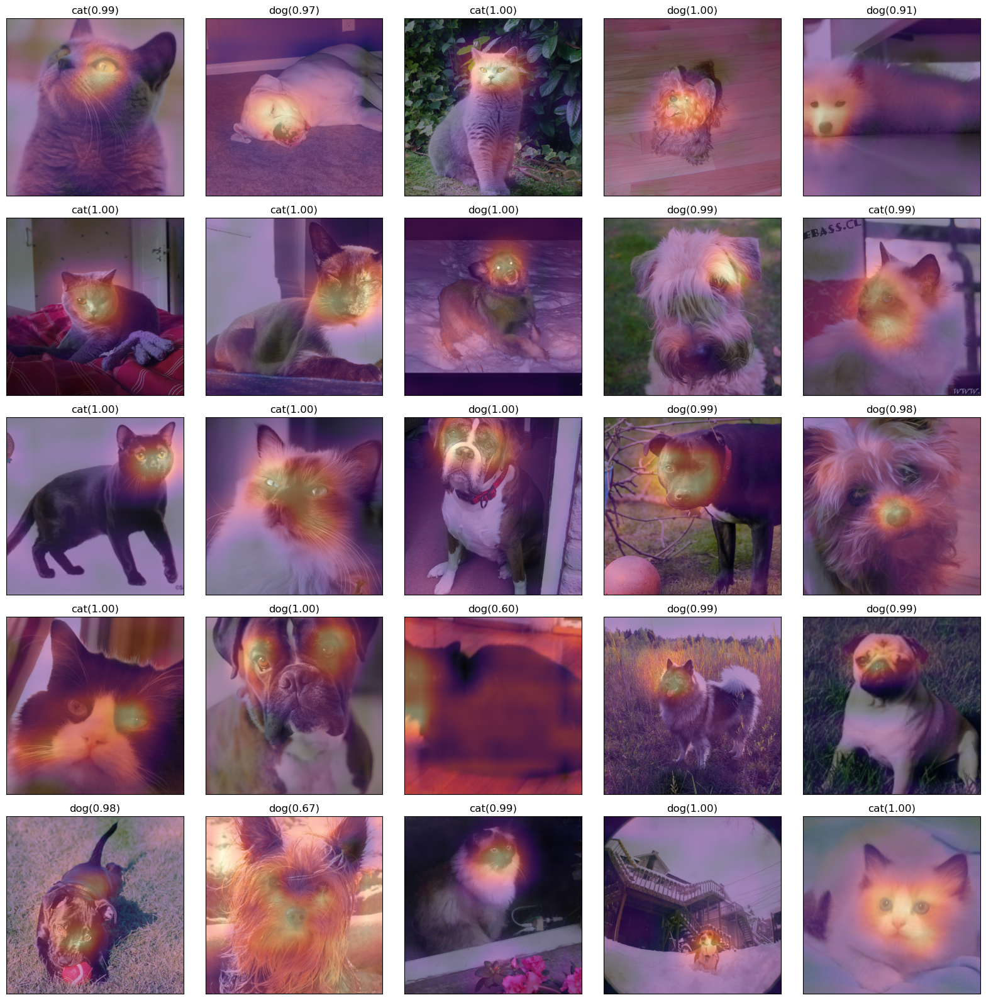

In [77]:
fig,ax = plt.subplots(5,5)
#---#
k=75
for i in range(5):
    for j in range(5):
        x_pil = fastai.vision.core.PILImage.create(fastai.data.transforms.get_image_files(path/'images')[k])
        x = next(iter(dls.test_dl([x_pil])))[0] # 이걸로 WHY를 만들어보자. 
        x_dec = dls.decode([x])[0] # 이걸로 시각화 
        WHY = torch.einsum('ocij,kc -> okij',net1(x),l.weight.data)
        WHYCAT = WHY[0,0,:,:].to("cpu").detach()
        WHYDOG = WHY[0,1,:,:].to("cpu").detach()
        cat_prob, dog_prob = softmax(flatten(mp(WHY))).to("cpu").detach().tolist()[0]
        if cat_prob > dog_prob: 
            ax[i][j].imshow(torch.einsum('ocij -> ijc',x_dec))
            ax[i][j].imshow(WHYCAT,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
            ax[i][j].set_title(f"cat({cat_prob:.2f})")
            ax[i][j].set_xticks([])
            ax[i][j].set_yticks([])            
        else: 
            ax[i][j].imshow(torch.einsum('ocij -> ijc',x_dec))
            ax[i][j].imshow(WHYDOG,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
            ax[i][j].set_title(f"dog({dog_prob:.2f})")
            ax[i][j].set_xticks([])
            ax[i][j].set_yticks([])            
        k=k+1
fig.set_figheight(16)
fig.set_figwidth(16)
fig.tight_layout()